# visualizing the images

In [1]:
# trainer
print("strawberry")
from trustworthai.utils.fitting_and_inference.fitters.basic_lightning_fitter import StandardLitModelWrapper
from trustworthai.utils.fitting_and_inference.get_trainer import get_trainer

# data
from twaidata.torchdatasets_v2.mri_dataset_inram import MRISegmentation3DDataset
from twaidata.torchdatasets_v2.mri_dataset_from_file import MRISegmentationDatasetFromFile, ArrayMRISegmentationDatasetFromFile
from twaidata.mri_dataset_directory_parsers.MSS3_multirater import MSS3MultiRaterDataParser

# packages
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torchinfo import summary
from tqdm import tqdm
from collections import defaultdict
from natsort import natsorted
import torchmetrics
print("banana")

strawberry
banana


In [2]:
import seaborn as sns
import scipy

### Loading MSS3 flair t1 mask dataset

In [3]:
from twaidata.torchdatasets_v2.mri_dataset_from_file import MRISegmentationDatasetFromFile, ArrayMRISegmentationDatasetFromFile
from twaidata.mri_dataset_directory_parsers.MSS3_multirater import MSS3MultiRaterDataParser

In [4]:
parser = MSS3MultiRaterDataParser(
        # paths on the cluster for the in house data
        "/home/s2208943/datasets/Inter_observer",
        "/home/s2208943/preprocessed_data/MSS3_InterRaterData"
    )

mss3_ds = ArrayMRISegmentationDatasetFromFile(parser) 

In [5]:
IDs = [v[2] for v in mss3_ds]

### Loading MSS3 predictions

In [6]:
def load_output_maps(output_maps_dir):
    output_maps_lists = defaultdict(lambda: [])
    for fID in tqdm(os.listdir(output_maps_dir), position=0, leave=True, ncols=100):
        # print(fID)
        # break
        if ".npz" in fID and "model_WMH_samples" not in fID:
            ID = fID.split("_out_maps")[0]
            output_maps_data = np.load(os.path.join(output_maps_dir,fID))
            key_order = natsorted(list(output_maps_data.keys()))
            for key in key_order:
                if key == "seg":
                    continue
                output_maps_lists[ID].append(torch.from_numpy(output_maps_data[key]))
    return output_maps_lists, key_order

In [7]:
# model_name = "SSN_Ens_Mean"
output_maps = {}
for model_name in ["ssn_ens", "punet", "deterministic"]:
    output_maps_dir = f"/home/s2208943/preprocessed_data/MSS3_InterRaterData/output_maps/{model_name}/"
    out_maps, key_order = load_output_maps(output_maps_dir)
    output_maps[model_name] = out_maps

100%|███████████████████████████████████████████████████████████████| 68/68 [00:38<00:00,  1.75it/s]


### Loading the Fazekas Categories

In [10]:
from trustworthai.journal_run.new_MIA_fazekas_and_QC.dataset_setup import *

In [11]:
cvd_data, adni_data, challenge_data, mss3_data = load_spreadsheets(include_MSS3=True)


challenge shapes before and after cleanup
(175, 1532)
(175, 1465)
cvd shapes before and after cleanup
(250, 1552)
(250, 1402)
adni shapes before and after cleanup
(299, 1544)
(299, 1374)
mss3 shapes before and after cleanup
(68, 46)
(68, 44)


In [12]:
IDs_map = {ID:"_".join(ID.split("_")[1:4]) for ID in IDs}
reverse_IDs_map = {value:key for key, value in IDs_map.items()}

In [18]:
mss3_data['ssn_ens']

,ID,WMH_PV,WMH_Deep,Total,dice,f1,avd,recall,deep_sample_div_std,deep_sample_div_IQR,...,all_sample_div_skew,all_sample_div_vd_std,all_sample_div_vd_IQR,all_sample_div_vd_skew,all_min_sample,all_max_sample,all_25th_p_sample,all_75th_p_sample,all_25th_p_vd,all_75th_p_vd
0,MSS3_ED_001_V1,2.0,1.0,3.0,0.704165,0.386266,22.023810,0.294118,560.570557,358.50,...,1.142419,75.044083,69.725884,1.142419,703.0,4420.0,1342.25,2347.00,-6.852880,62.873005
1,MSS3_ED_002_V1,3.0,3.0,6.0,0.537512,0.328947,61.581569,0.200000,1396.016846,1430.00,...,0.334688,48.475227,56.559517,0.334688,2409.0,11334.0,4641.00,7781.75,-16.423555,40.135962
2,MSS3_ED_003_V1,2.0,2.0,4.0,0.528705,0.441983,61.660237,0.306452,282.660065,267.50,...,0.219098,48.056366,62.083624,0.219098,1253.0,5680.0,2356.25,4145.50,-18.242540,43.841084
3,MSS3_ED_004_V1,3.0,2.0,5.0,0.472049,0.297359,68.100723,0.175926,170.669144,181.75,...,0.312798,35.019558,43.212389,0.312797,1599.0,4888.0,2374.00,3594.75,-15.964601,27.247787
4,MSS3_ED_005_V1,1.0,1.0,2.0,0.234711,0.137246,83.359980,0.075410,804.294434,861.75,...,0.853284,98.984100,111.104955,0.853284,551.0,4920.0,1230.00,2733.25,-9.090909,102.014046
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,MSS3_ED_017_V0,NaN,NaN,NaN,0.287648,0.353086,57.864358,0.230088,125.153061,116.25,...,0.446312,50.620552,61.130136,0.446312,443.0,1877.0,750.75,1286.25,-14.297945,46.832191
64,MSS3_ED_050_V0,NaN,NaN,NaN,0.763039,0.472959,37.415579,0.320513,1717.650513,1651.75,...,0.313657,25.046648,26.580737,0.313657,8067.0,18731.0,11184.75,14510.00,-10.593526,15.987211
65,MSS3_ED_050_V2b,NaN,NaN,NaN,0.627215,0.439093,52.440571,0.296970,866.251099,972.75,...,0.223477,34.942036,41.340386,0.223478,3456.0,10382.0,5292.00,7773.25,-11.829391,29.510996
66,MSS3_ED_050_V3,NaN,NaN,NaN,0.638214,0.316424,52.162269,0.190217,645.014221,754.50,...,0.114523,26.482073,31.018442,0.114522,3675.0,9092.0,5261.75,7145.50,-13.358308,17.660134


In [34]:
mask_vols = []
wmh_vols = []
fazekas_pv = []
fazekas_deep = []
for sid in mss3_data['ssn_ens']['ID']:
    iid = sid
    scan_id = np.where(np.array(IDs) == iid)[0].item()
    data = mss3_ds[scan_id]
    mask = data[0][2]
    wmh = data[1][-1]
    
    wmh_vol = wmh.sum().item()
    mask_vol = mask.sum().item()
    
    mask_vols.append(mask_vol)
    wmh_vols.append(wmh_vol)
    fazekas_pv.append(mss3_data['ssn_ens'][mss3_data['ssn_ens']['ID'] == sid]['WMH_PV'].values[0])
    fazekas_deep.append(mss3_data['ssn_ens'][mss3_data['ssn_ens']['ID'] == sid]['WMH_Deep'].values[0])
    

In [35]:
mask.shape

torch.Size([53, 240, 240])

In [36]:
stats_df = {
    "wmh_vol":wmh_vols,
    "mask_vol":mask_vols,
    "faz_pv":fazekas_pv,
    "faz_deep":fazekas_deep,
    "wmh_to_brain_size": np.array(wmh_vols) / np.array(mask_vols)
}

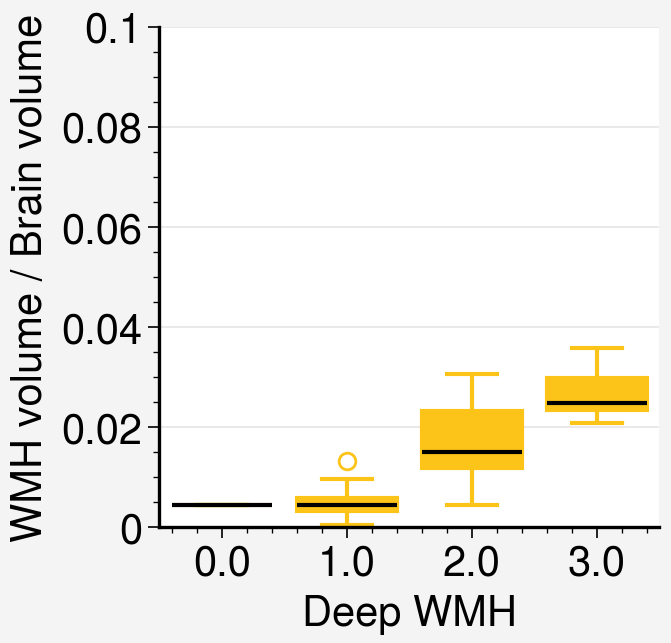

In [61]:
colour = "yellow5"
fig, ax = pplt.subplots(ncols=1, nrows=1, fontsize=15)
boxplot = sns.boxplot(stats_df, x='faz_deep', y='wmh_to_brain_size', ax=ax, color=colour, linewidth=1.5, linecolor=colour)

for i, box in enumerate(boxplot.artists):
    boxplot.lines[4 + (i * 6)].set_color('black')
# make the face colour consistent
for patch in boxplot.artists:
    patch.set_facecolor(colour)

plt.ylim(0, 0.1)
ax.set_xticks(range(0, 4))
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.spines['bottom'].set_linewidth(1.2)  # Thicker bottom spine
ax.spines['left'].set_linewidth(1.2)  # Thicker left spine
ax.format(xlabel="Deep WMH", ylabel="WMH volume / Brain volume")
fig.save("images/mss3_deep_vol_dist.pdf")


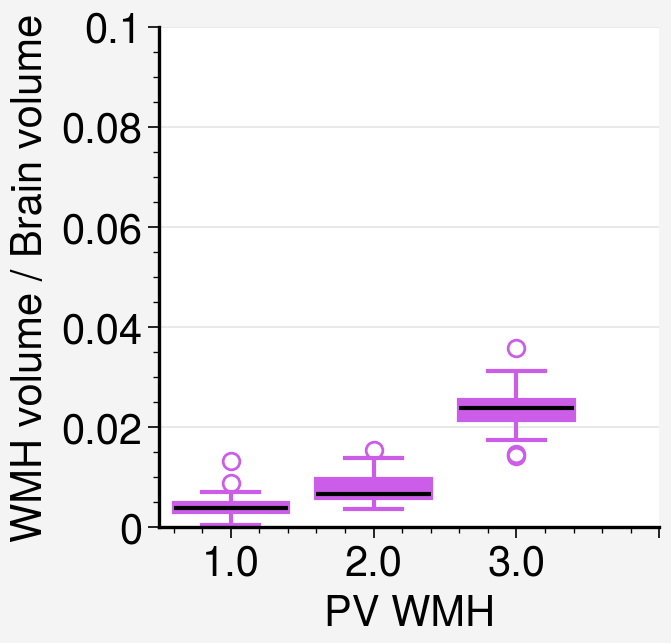

In [62]:
colour = "grape5"
fig, ax = pplt.subplots(ncols=1, nrows=1, fontsize=15)
boxplot = sns.boxplot(stats_df, x='faz_pv', y='wmh_to_brain_size', ax=ax, color=colour, linewidth=1.5, linecolor=colour)

for i, box in enumerate(boxplot.artists):
    boxplot.lines[4 + (i * 6)].set_color('black')
# make the face colour consistent
for patch in boxplot.artists:
    patch.set_facecolor(colour)

plt.ylim(0, 0.1)
ax.set_xticks(range(0, 4))
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.spines['bottom'].set_linewidth(1.2)  # Thicker bottom spine
ax.spines['left'].set_linewidth(1.2)  # Thicker left spine
ax.format(xlabel="PV WMH", ylabel="WMH volume / Brain volume")

fig.save("images/mss3_pv_vol_dist.pdf")

In [11]:
import proplot as pplt
import SimpleITK as sitk

In [12]:
def plot_brain_image(ds, IDs, output_maps_ssnens, output_maps_deterministic, target_pID, df, reverse_IDs_map):
    IDs = np.array(IDs)
    scan_id = np.where(IDs == reverse_IDs_map[target_pID])[0].item()
    
    nslices = ds[scan_id][0][0].shape[0]
    gap = nslices // 6

    fig = pplt.figure(space=0, refwidth='20em')
    axs = fig.subplots(nrows=4, ncols=6)
    # axs.format(grid=False, xlocator='null', ylocator='null')
    # for ax in axs:
    #     for spine in ax.spines:
    #         ax.spines[spine].set_color('none')
            
    # print(ds[scan_id][0][0].shape)
    
    # imgpath = f'/disk/scratch/s2208943/MOUNTS/BRICIA/E181935_MSS_III_Res/MRI/STRUCTURAL_ALL_VISITS/MSS3_{key[0:6]}/ses_V{key.split("V")[1]}/segmentations/Strokes/MSS3_{key}_strokes_binary.nii.gz'
    imgpath = f'/disk/scratch/s2208943/MOUNTS/BRICIA/E181935_MSS_III_Res/MRI/STRUCTURAL_ALL_VISITS/MSS3_{key[0:6]}/ses_V{key.split("V")[1]}/overlays/MSS3_{key}_WMH_and_strokes.nii.gz'
    img = sitk.ReadImage(imgpath)

#     original_spacing = img.GetSpacing()
#     original_size = img.GetSize()
#     out_spacing = (1,1,3)

#     out_size = [
#         int(np.round(orig_size * orig_spacing / out_spacing))
#         for (orig_size, orig_spacing, out_spacing) 
#         in zip(original_size, original_spacing, out_spacing)
#     ]
#     resample = sitk.ResampleImageFilter()
#     resample.SetOutputSpacing(original_spacing)
#     resample.SetSize(out_size)
#     resample.SetOutputDirection(img.GetDirection())      # sets the output direction cosine matrix...
#     resample.SetOutputOrigin(img.GetOrigin())
#     resample.SetTransform(sitk.Transform())
#     resample.SetDefaultPixelValue(0)#itk_image.GetPixelIDValue())
#     resample.SetInterpolator(sitk.sitkNearestNeighbor)
#     img = resample.Execute(img)
    arr = sitk.GetArrayFromImage(img)
    
    # print(np.unique(arr))
    # if len(np.unique(arr)) == 1:
    #     return

    for i in range(4):
        row = i * 6
        islice = gap * (i + 1) + 4

        # flair
        axs[row].imshow(ds[scan_id][0][0][islice], cmap='gray', vmin=-3, vmax=3, origin='lower')

        # flair + umap
        axs[row +1].imshow(ds[scan_id][0][0][islice], cmap='gray', vmin=-3, vmax=3, origin='lower')
        axs[row +1].imshow(output_maps_ssnens[IDs[scan_id]][0][islice], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

        # flair + seg
        axs[row +2].imshow(ds[scan_id][0][0][islice], cmap='gray', vmin=-3, vmax=3, origin='lower')
        axs[row +2].imshow(output_maps_ssnens[IDs[scan_id]][1][islice] > 0.5, alpha=0.7, vmin=0, vmax=1, cmap='Greens', origin='lower')  
        
        # flair + umap
        axs[row +3].imshow(ds[scan_id][0][0][islice], cmap='gray', vmin=-3, vmax=3, origin='lower')
        axs[row +3].imshow(output_maps_deterministic[IDs[scan_id]][0][islice], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

        # flair + seg
        axs[row +4].imshow(ds[scan_id][0][0][islice], cmap='gray', vmin=-3, vmax=3, origin='lower')
        axs[row +4].imshow(output_maps_deterministic[IDs[scan_id]][1][islice] > 0.5, alpha=0.7, vmin=0, vmax=1, cmap='Greens', origin='lower')  
        
        # flair + stroke
        axs[row +5].imshow(arr[int(islice * arr.shape[0]/ds[scan_id][0][0].shape[0])], cmap='gray', origin='lower', vmin=0, vmax=18000) 

    # fig.savefig("figname.png", bbox_inches='tight', dpi=300)

ED_102_V4


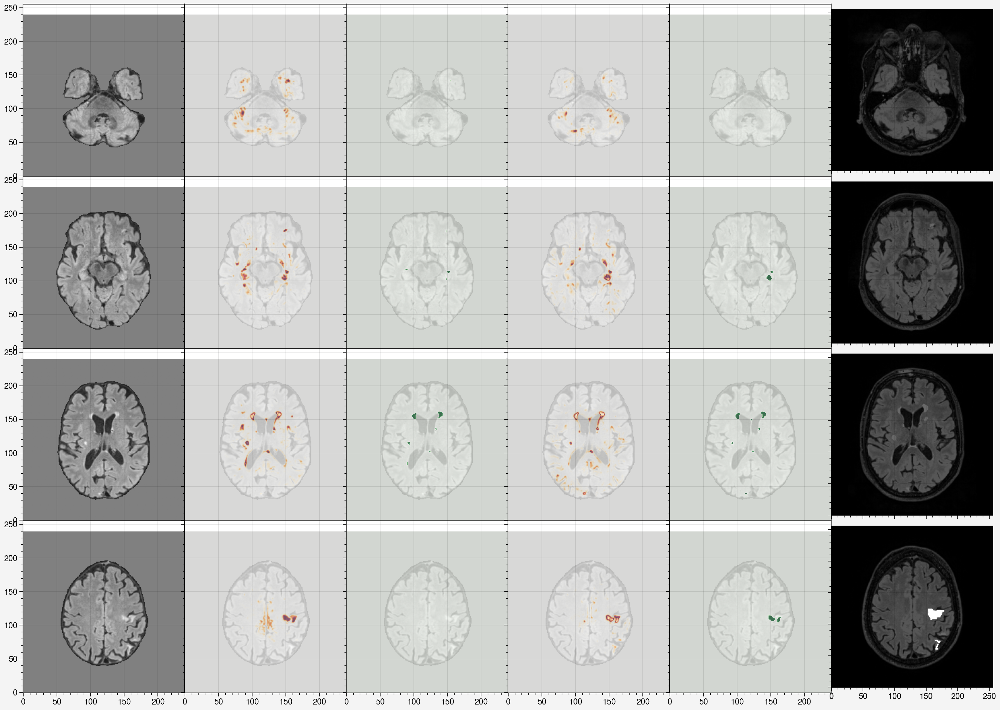

ED_102_V0


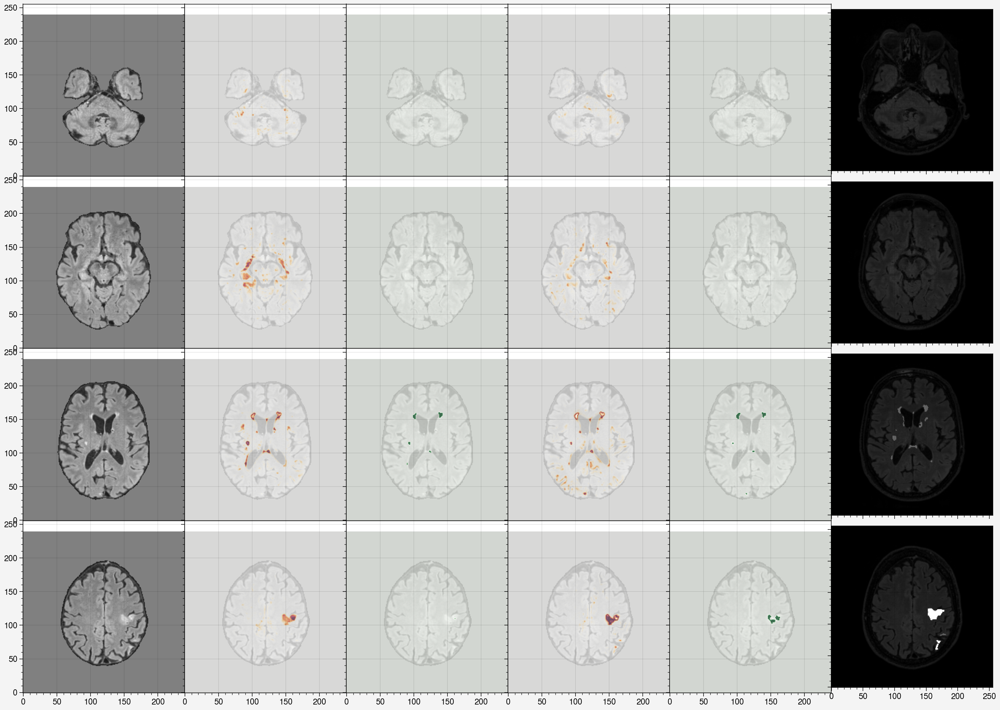

ED_077_V1


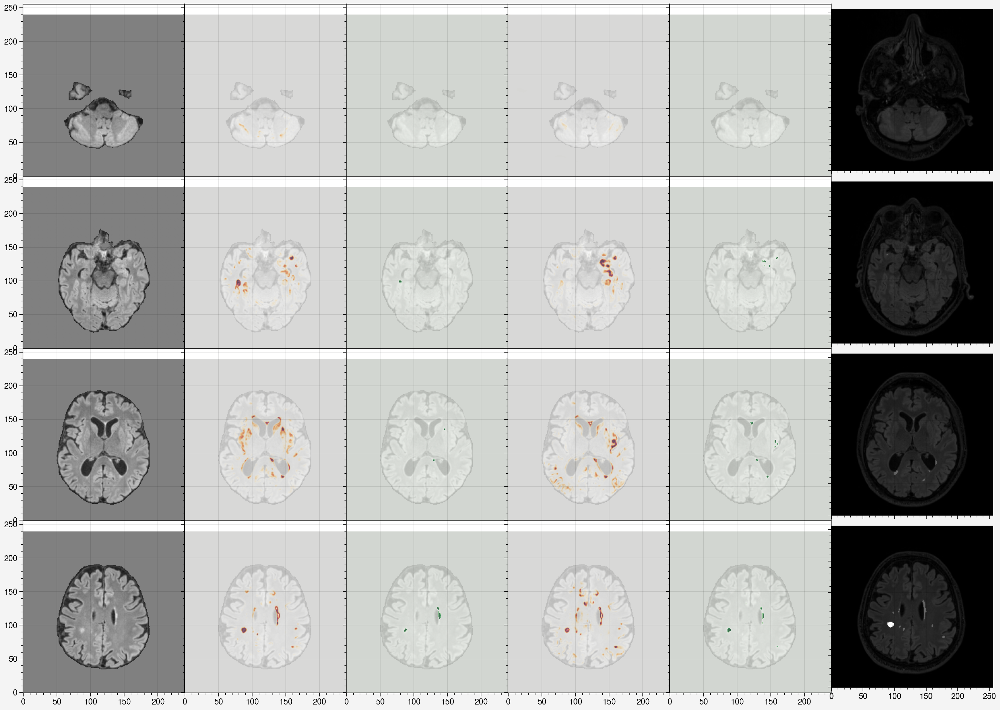

ED_050_V0


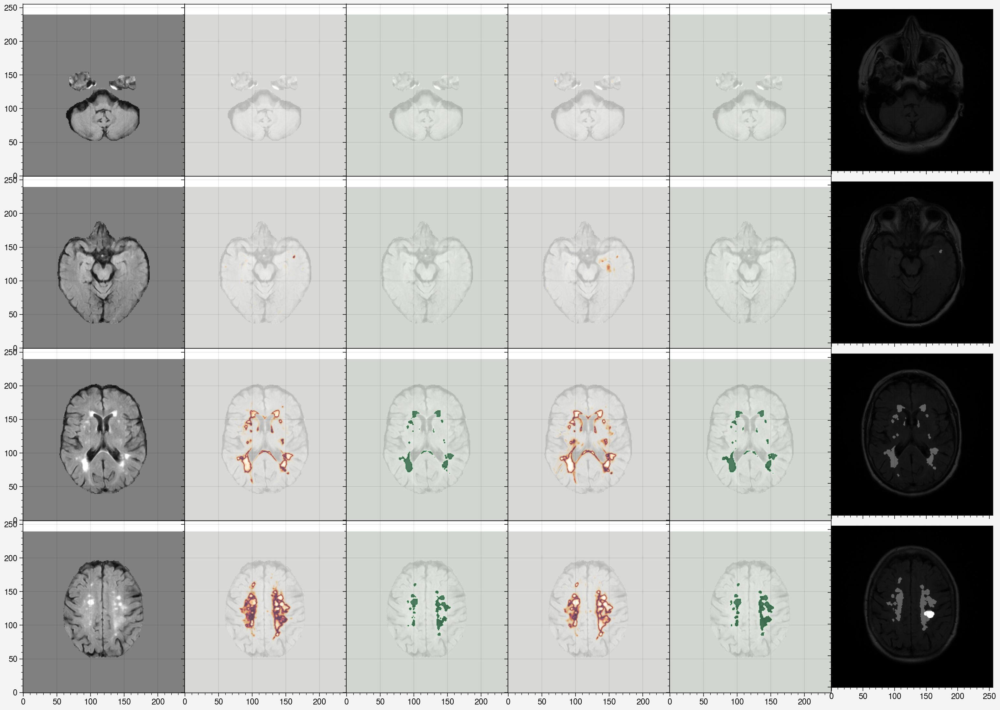

ED_041_V1


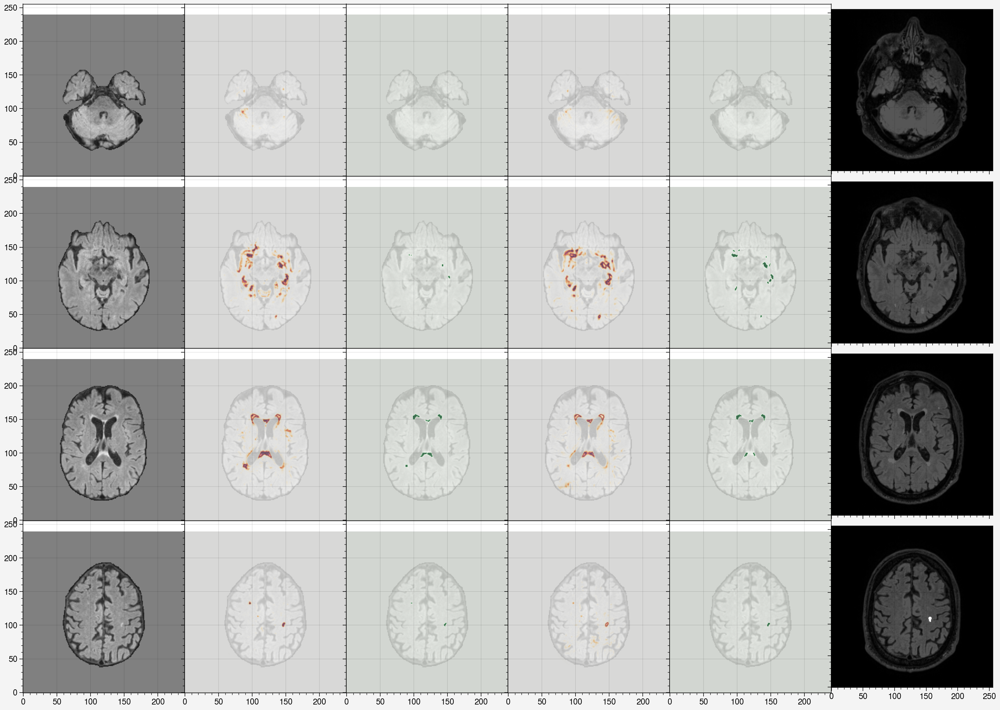

ED_038_V1


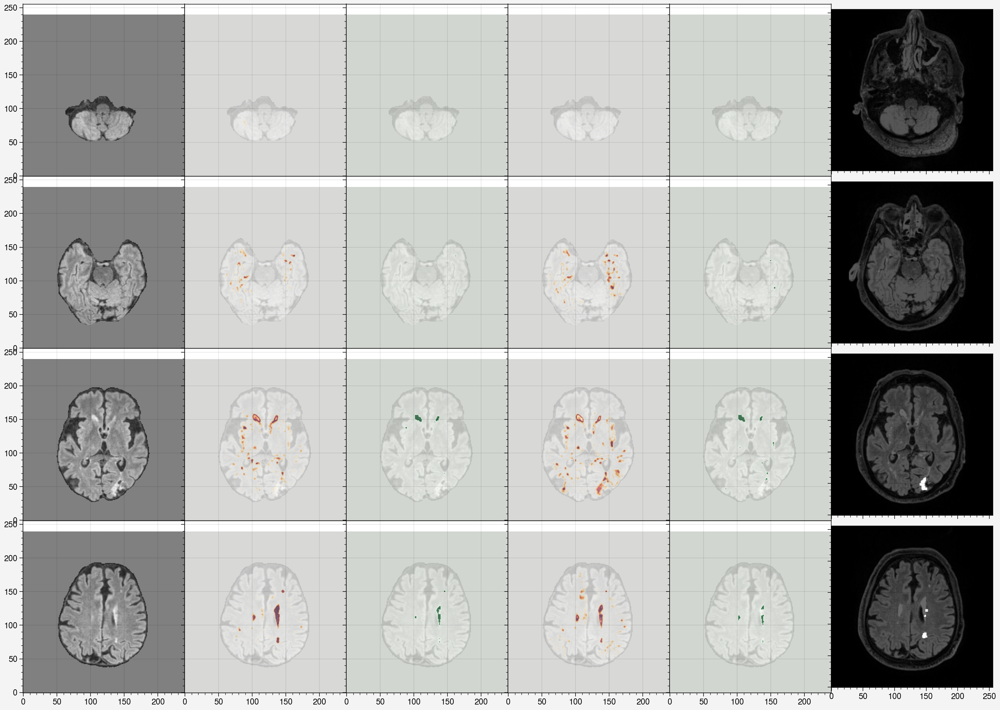

ED_027_V1


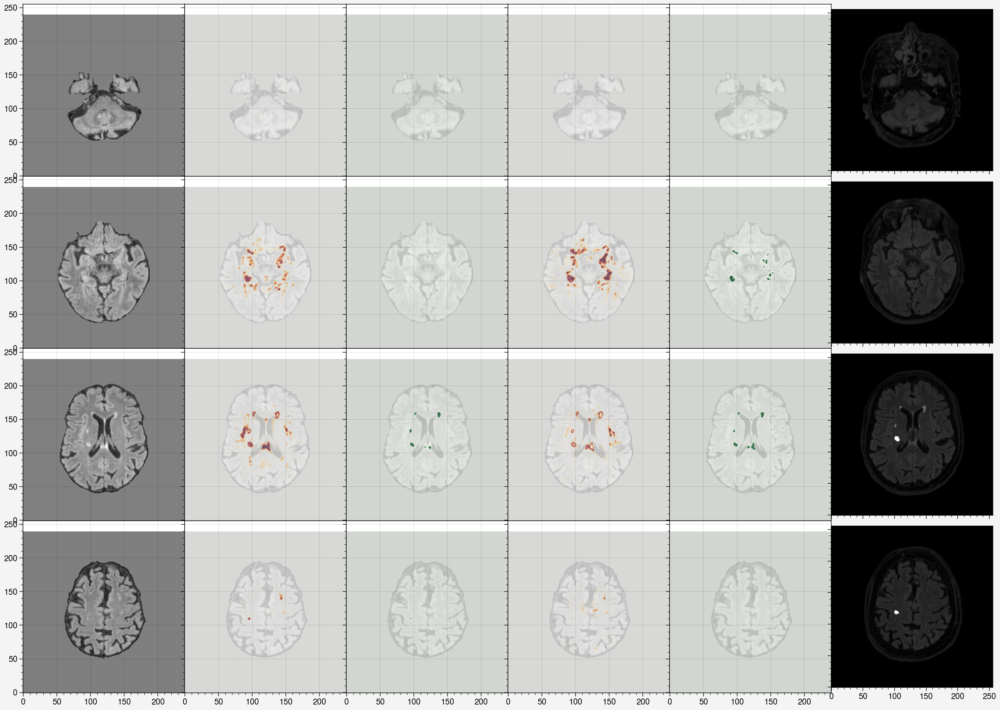

ED_029_V1


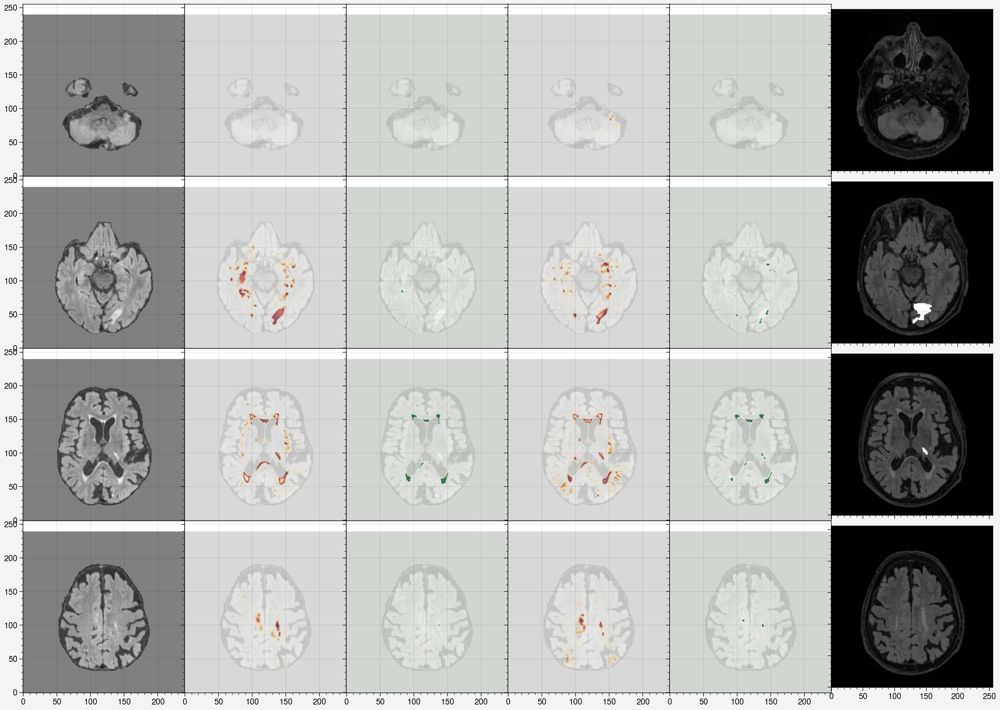

ED_024_V1


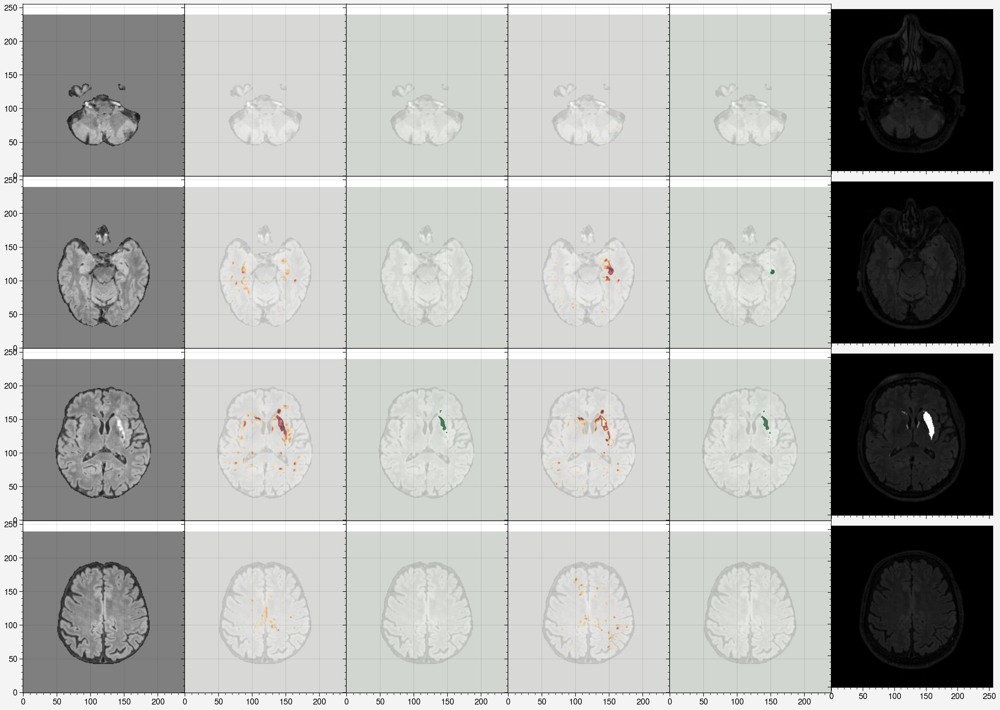

ED_020_V1


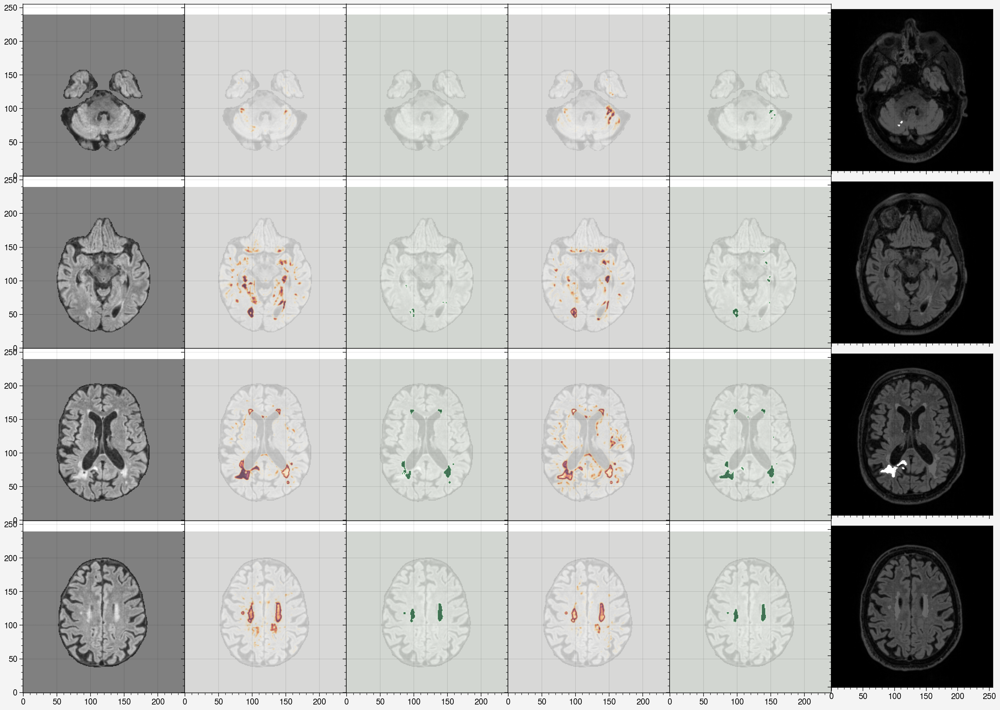

ED_019_V1


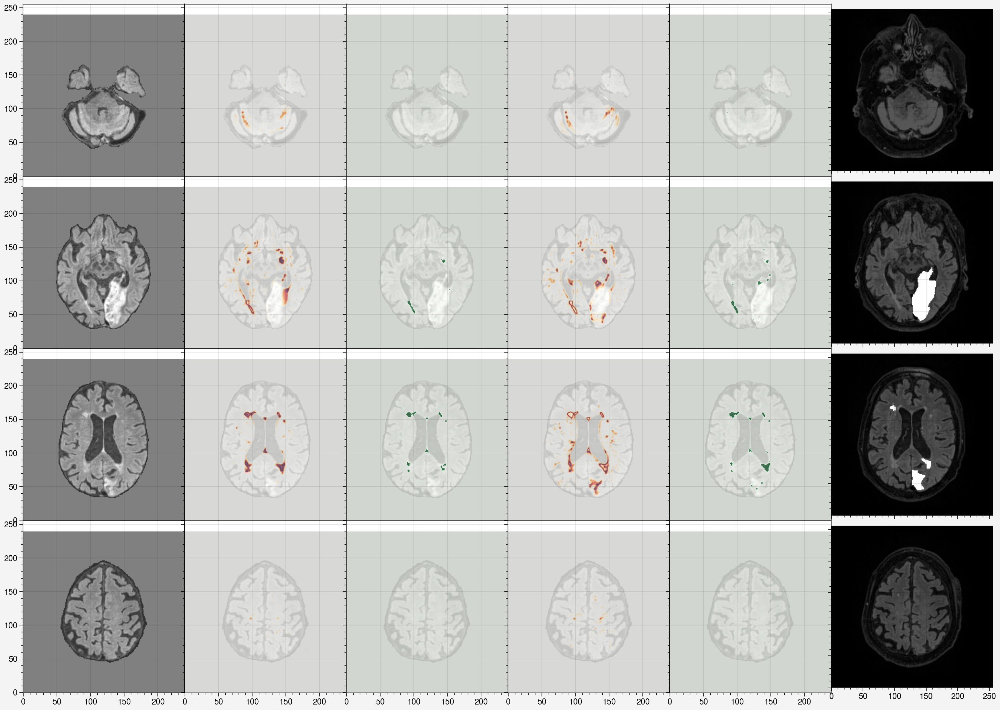

ED_013_V1


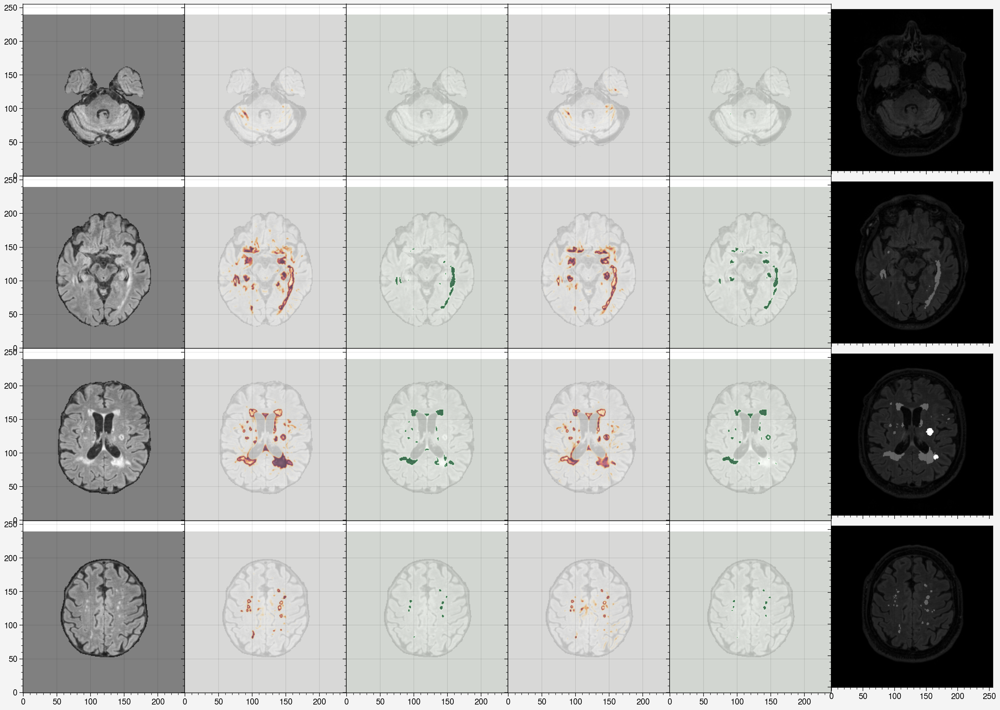

ED_012_V1


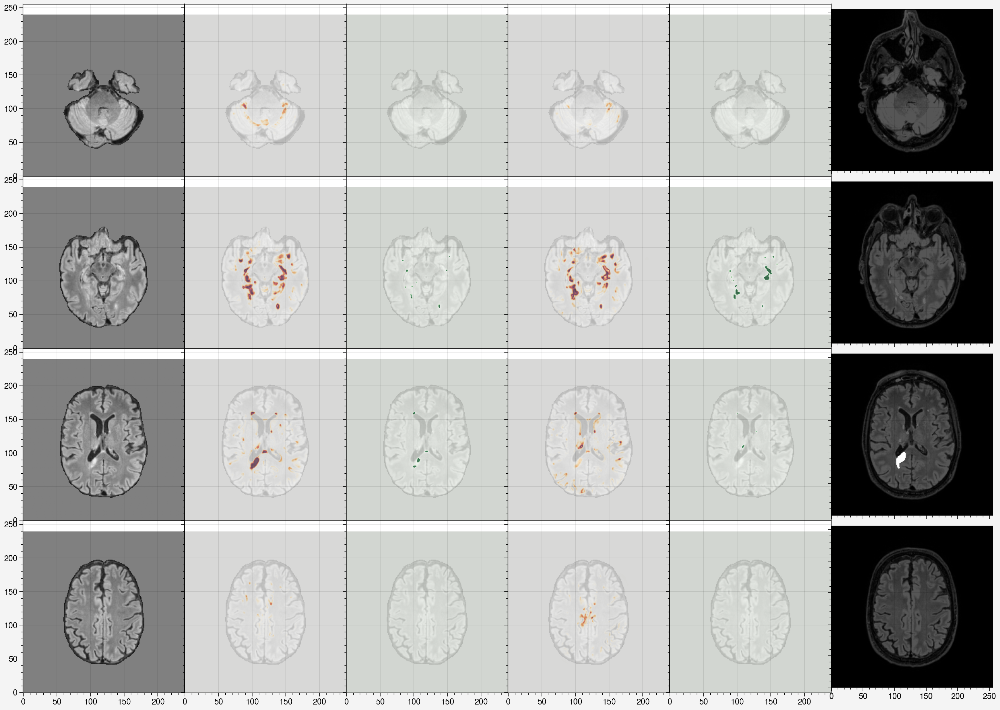

ED_009_V1


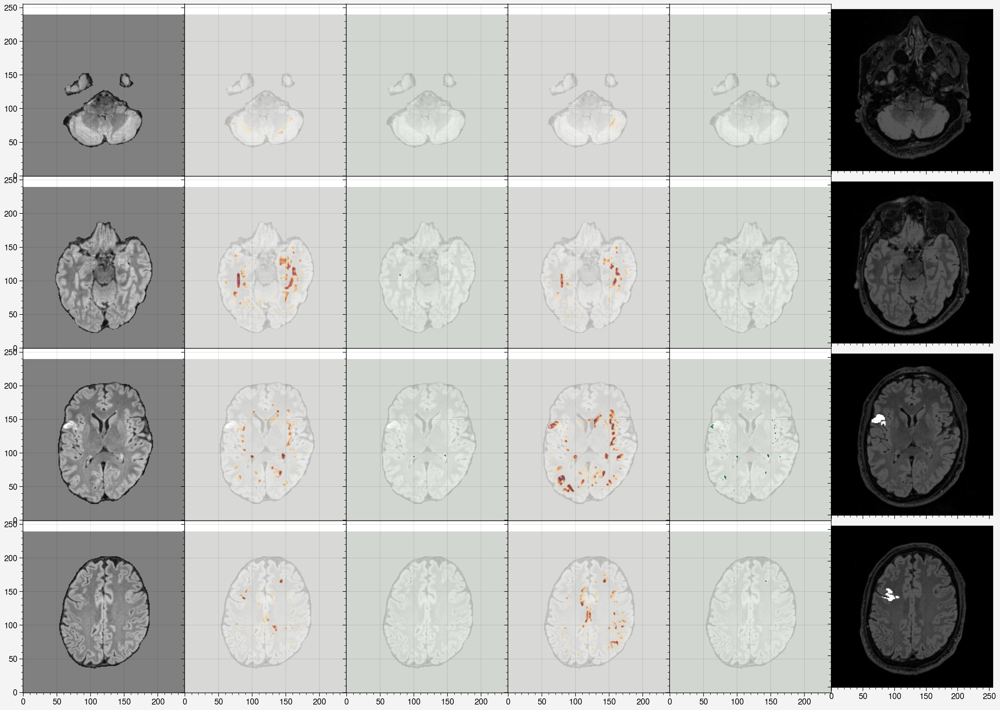

ED_005_V1


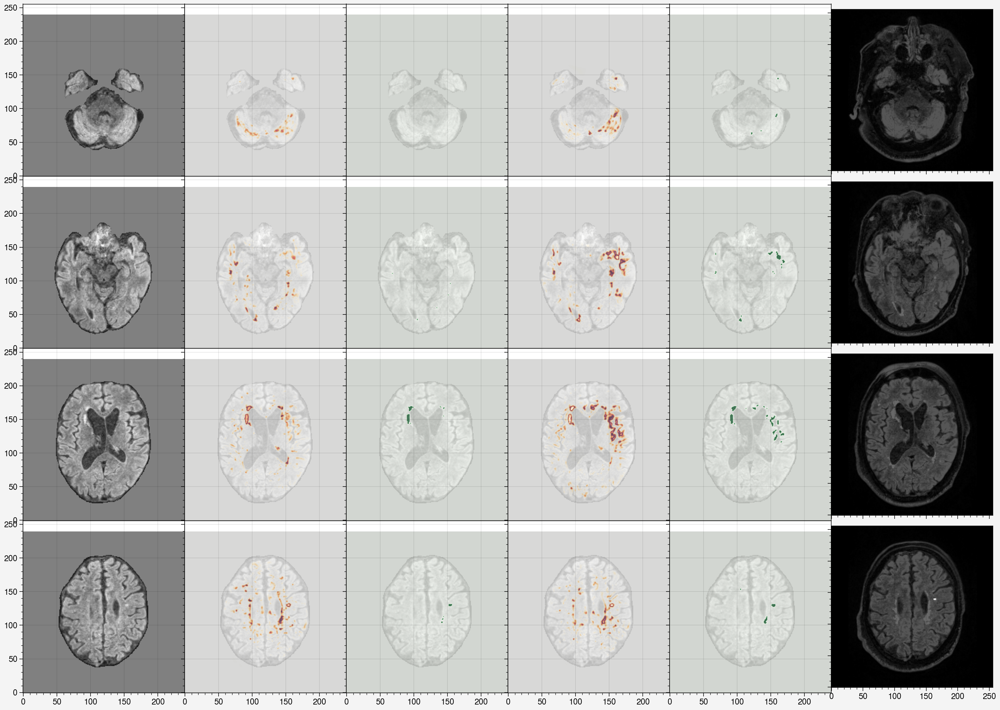

In [14]:
# for key in list(reverse_IDs_map.keys())[::-1]:
# for key in ['ED_020_V1']:
for key in 'ED_102_V4 ED_102_V0 ED_077_V1 ED_050_V0 ED_041_V1 ED_038_V1 ED_027_V1 ED_029_V1 ED_024_V1 ED_020_V1 ED_019_V1 ED_013_V1 ED_012_V1 ED_009_V1 ED_005_V1'.split(' '):
    print(key)
    plot_brain_image(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], key, mss3_data['ssn_ens'], reverse_IDs_map)
    plt.show()

In [15]:
def plot_brain_image_singlesice(ds, IDs, output_maps_ssnens, output_maps_deterministic, target_pID, df, reverse_IDs_map, islice_index, r1=20, r2=10, figtitles=False, circle_centre=None, circle_radius=None, second_circle_centre=None, second_circle_radius=None, mark_locs=None):
    IDs = np.array(IDs)
    scan_id = np.where(IDs == reverse_IDs_map[target_pID])[0].item()
    
    nslices = ds[scan_id][0][0].shape[0]
    gap = nslices // 6
    islice = gap * (islice_index + 1) + 4

    fig = pplt.figure(space=0, refwidth='20em')
    axs = fig.subplots(nrows=1, ncols=5)
    axs.format(grid=False, xlocator='null', ylocator='null')
    for ax in axs:
        for spine in ax.spines:
            ax.spines[spine].set_color('none')

            
    flair = ds[scan_id][0][0]
    flair = flair.clone()
    mask = ds[scan_id][0][2]
    flair[mask==0] = flair.min()
            
    # flair
    axs[0].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    if circle_centre is not None:
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='black', fill=False, linewidth=3.5)
        axs[0].add_patch(circle)
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='white', fill=False, linewidth=1.7)
        axs[0].add_patch(circle)
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='r', fill=False, linewidth=1.7, linestyle='--')
        axs[0].add_patch(circle)
        
    if second_circle_centre is not None:
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='black', fill=False, linewidth=3.5)
        axs[0].add_patch(circle)
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='white', fill=False, linewidth=1.7)
        axs[0].add_patch(circle)
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='r', fill=False, linewidth=1.7, linestyle='--')
        axs[0].add_patch(circle)
        
    if mark_locs is not None:
        for mark in mark_locs:
            axs[0].scatter(mark[0], mark[1], marker=mark[2], s=100, c='white')
            # axs[0].scatter(mark[0], mark[1], marker=mark[2], s=50, c='grape7')

    # flair + umap ssn ens
    axs[1].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[1].imshow(output_maps_ssnens[IDs[scan_id]][0][islice][r1:-r1, r2:-r2], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

    # flair + ssn ens
    axs[2].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[2].imshow(output_maps_ssnens[IDs[scan_id]][1][islice][r1:-r1, r2:-r2] > 0.5, alpha=0.7, vmin=0, vmax=1, cmap='Greens', origin='lower')  
    
    # flair + umap deterministic
    axs[3].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[3].imshow(output_maps_deterministic[IDs[scan_id]][0][islice][r1:-r1, r2:-r2], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

    # flair + ssn ens
    axs[4].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[4].imshow(output_maps_deterministic[IDs[scan_id]][1][islice][r1:-r1, r2:-r2] > 0.5, alpha=0.7, vmin=0, vmax=1, cmap='Greens', origin='lower')
    
    if figtitles:
        # axs[0].set_title("FLAIR", fontweight='bold')
        axs[1].set_title("SSN-Ens UQ map", fontweight='bold')
        axs[2].set_title("SSN-Ens WMH seg.", fontweight='bold')
        axs[3].set_title("SEnt UQ map", fontweight='bold')
        axs[4].set_title("SEnt WMH seg.", fontweight='bold')
        axs.format(titleloc='lc', titleborder=False, fontsize=13)

    plt.savefig(f"images/mss3_{target_pID}_{islice_index}.png", dpi=200)
    plt.show()

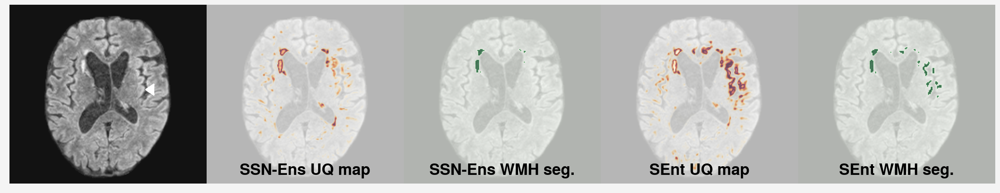

In [16]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_005_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=2, r1=20, r2=10, figtitles=True, mark_locs=[[152, 105, 4]])

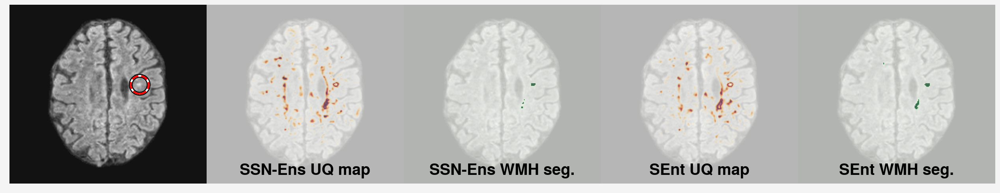

In [17]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_005_V1', 
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=3, r1=20, r2=10, figtitles=True, circle_centre=(155, 130), circle_radius=10)

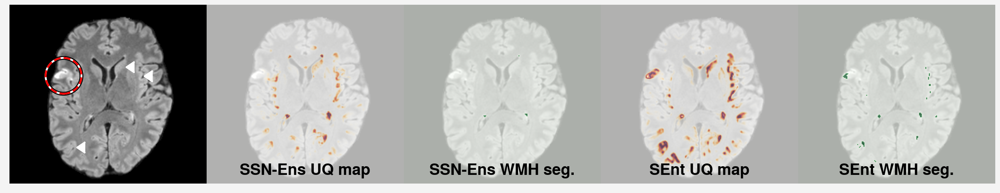

In [18]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_009_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=2, r1=20, r2=10, figtitles=True, circle_centre=(70, 140), circle_radius=20, mark_locs=[[150, 120, 4], [130, 130, 4], [75, 40, 4]])

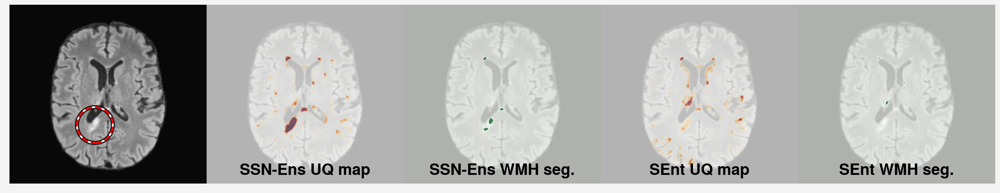

In [19]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_012_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=2, r1=20, r2=10, figtitles=True, circle_centre=(105, 85), circle_radius=20)

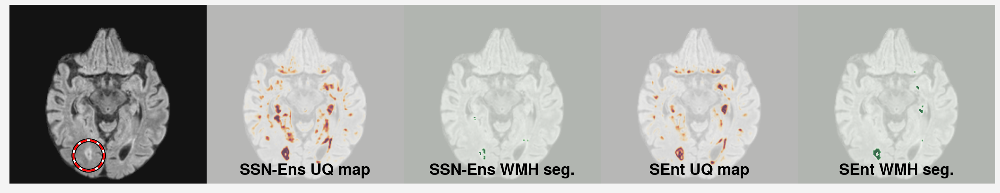

In [20]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_020_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=1, r1=20, r2=10, figtitles=True, circle_centre=(98, 51), circle_radius=17)

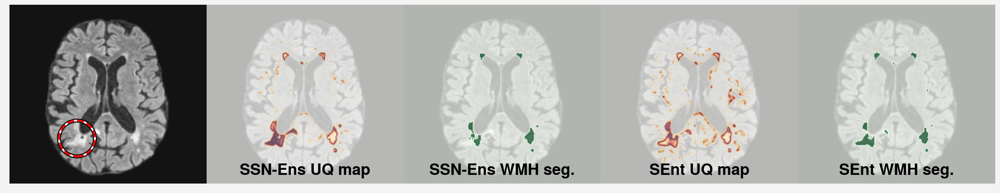

In [21]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_020_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=2, r1=20, r2=10, figtitles=True, circle_centre=(85, 70), circle_radius=20)

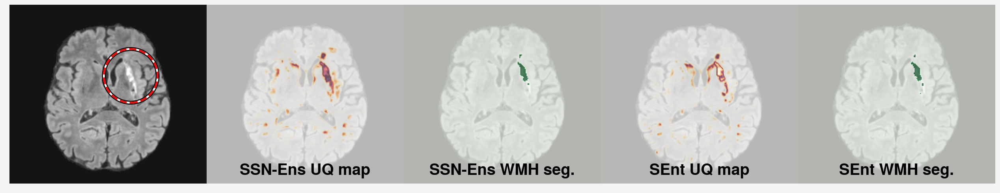

In [22]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_024_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=2, r1=20, r2=10, figtitles=True, circle_centre=(145, 140), circle_radius=30)

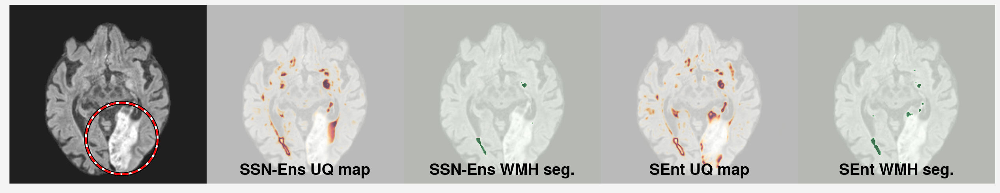

In [23]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_019_V1',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=1, r1=20, r2=10, figtitles=True, circle_centre=(135, 70), circle_radius=40)

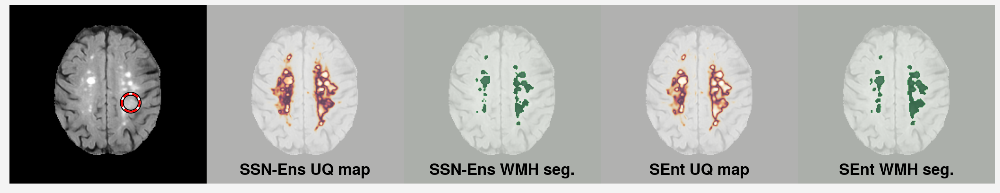

In [24]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_050_V0',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=3, r1=20, r2=10, figtitles=True, circle_centre=(145, 110), circle_radius=10)

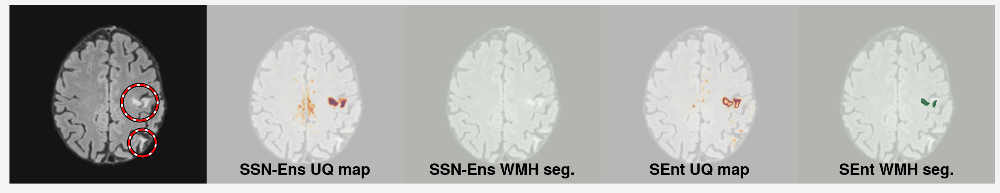

In [25]:
plot_brain_image_singlesice(mss3_ds, IDs, output_maps['ssn_ens'], output_maps['deterministic'], 'ED_102_V4',
                            mss3_data['ssn_ens'], reverse_IDs_map, islice_index=3, r1=20, r2=10, figtitles=True, circle_centre=(155, 110), circle_radius=20,
                           second_circle_centre=(158, 65), second_circle_radius=15)

In [26]:
def plot_brain_image_punet_comparison(ds, IDs, output_maps_ssnens, output_maps_punet, target_pID, df, reverse_IDs_map, islice_index, r1=20, r2=10, figtitles=False, circle_centre=None, circle_radius=None, second_circle_centre=None, second_circle_radius=None, mark_locs=None):
    IDs = np.array(IDs)
    scan_id = np.where(IDs == reverse_IDs_map[target_pID])[0].item()
    
    nslices = ds[scan_id][0][0].shape[0]
    gap = nslices // 6
    islice = gap * (islice_index + 1) + 4

    fig = pplt.figure(space=0, refwidth='20em')
    axs = fig.subplots(nrows=1, ncols=2)
    axs.format(grid=False, xlocator='null', ylocator='null')
    for ax in axs:
        for spine in ax.spines:
            ax.spines[spine].set_color('none')

    flair = ds[scan_id][0][0]
    flair = flair.clone()
    mask = ds[scan_id][0][2]
    flair[mask==0] = flair.min()
            
    axs[0].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    if circle_centre is not None:
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='black', fill=False, linewidth=3.5)
        axs[0].add_patch(circle)
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='white', fill=False, linewidth=1.7)
        axs[0].add_patch(circle)
        circle = plt.Circle((circle_centre[0]-r2, circle_centre[1]-r1), radius=circle_radius, color='r', fill=False, linewidth=1.7, linestyle='--')
        axs[0].add_patch(circle)
        
    if second_circle_centre is not None:
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='black', fill=False, linewidth=3.5)
        axs[0].add_patch(circle)
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='white', fill=False, linewidth=1.7)
        axs[0].add_patch(circle)
        circle = plt.Circle((second_circle_centre[0]-r2, second_circle_centre[1]-r1), radius=second_circle_radius, color='r', fill=False, linewidth=1.7, linestyle='--')
        axs[0].add_patch(circle)
        
    if mark_locs is not None:
        for mark in mark_locs:
            axs[0].scatter(mark[0], mark[1], marker=mark[2], s=100, c='white')
            # axs[0].scatter(mark[0], mark[1], marker=mark[2], s=50, c='grape7')

    # flair + umap ssn ens
    axs[0].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[0].imshow(output_maps_ssnens[IDs[scan_id]][0][islice][r1:-r1, r2:-r2], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

    # flair + umap punet
    axs[1].imshow(flair[islice][r1:-r1, r2:-r2], cmap='gray', vmin=-3, vmax=3, origin='lower')
    axs[1].imshow(output_maps_punet[IDs[scan_id]][0][islice][r1:-r1, r2:-r2], alpha=0.7, vmin=0, vmax=0.7, origin='lower') 

    
    if figtitles:
        # axs[0].set_title("FLAIR", fontweight='bold')
        axs[0].set_title("SSN-Ens UQ map", fontweight='bold')
        axs[1].set_title("P-Unet UQ map", fontweight='bold')
        axs.format(titleloc='lc', titleborder=False, fontsize=13)

    plt.savefig(f"images/mss3_punet_compare_{target_pID}_{islice_index}.png", dpi=200)
    plt.show()